Pancreas: Run64_Pankreas_ROI6, Run64_Pankreas_ROI8, Run64_Pankreas_ROI10, Run64_Pankreas_ROI12, Run64_Pankreas_ROI14, Run64_Pankreas_ROI15, Run64_Pankreas_ROI19, Run64_Pankreas_ROI22

In [1]:
from anndata import AnnData
import anndata as ad
import scanpy as sc
import squidpy as sq
import pandas as pd
import numpy as np
import seaborn as sns
from numpy.random import default_rng
import matplotlib.pyplot as plt
from scipy.stats import zscore
#from matplotlib.pyplot import figure

sc.logging.print_header()
print(f"squidpy=={sq.__version__}")

scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.21.6 scipy==1.7.3 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.9.10 pynndescent==0.5.7
squidpy==1.2.2


# Settings

In [2]:
# save results in:
import os
# Make a single directory
if not os.path.exists('results_subcluster_ROI12'):
    os.mkdir('results_subcluster_ROI12')

In [3]:
# figure & saving settings
sc.settings.set_figure_params(dpi=160, fontsize=20, dpi_save=300, figsize=(7,7))
sc.settings.figdir = 'results_subcluster_ROI12'

In [4]:
name = 'ROI12'

# Read in data

In [5]:
ROI12 = sc.read_h5ad('data/ROI12.h5ad')
ROI12

AnnData object with n_obs × n_vars = 8791 × 38
    obs: 'leiden'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

# Assign immune/ non immune cells

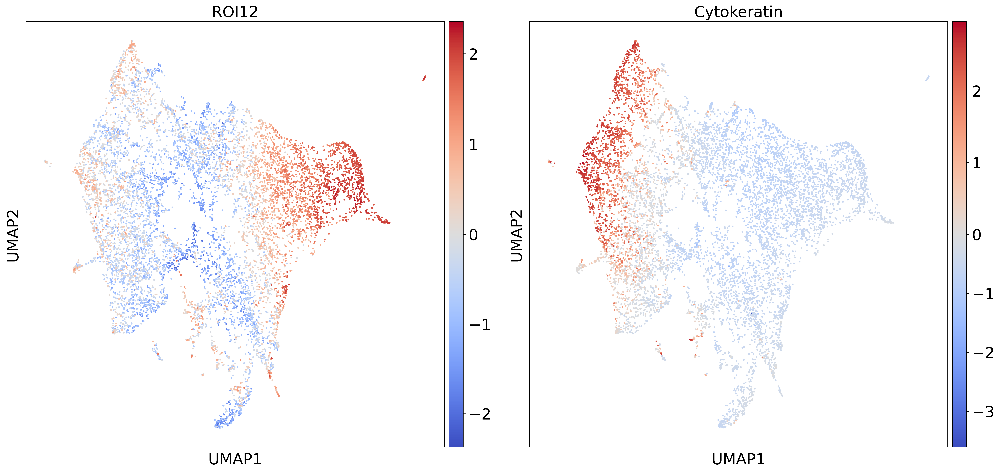

In [6]:
sc.settings.set_figure_params(dpi=220, fontsize=20, dpi_save=700, figsize=(10,10))
sc.pl.umap(ROI12, color=['CD45', 'Cytokeratin'], s=20, use_raw=False,  legend_fontsize=12, title = 'ROI12',  color_map='coolwarm', vcenter=0)

In [7]:
immune_type= {
'0' : 'non',
'1' : 'Immune cells',
'2' : 'non',
'3' : 'non',
'4' : 'non',
'5' : 'non', 
'6' : 'Immune cells',
'7' : 'Immune cells',
'8' : 'Immune cells',
'9' : 'non', 
'10' : 'Immune cells',
'11' : 'non',
'12' : 'non',
'13' : 'non',
'14' : 'Immune cells', 
'15' : 'Immune cells',
'16' : 'Immune cells', 
'17' : 'Immune cells',
'18' : 'non',
'19' : 'non',
'20' : 'non',
'21' :'non',
'22' : 'Immune cells',
'23' : 'non',
'24' : 'non',
'25' : 'Immune cells',
'26' : 'non',
'27' : 'non',
'28' : 'non', 
'29' : 'non', 
'30' : 'non',
'31' : 'Immune cells',
'32' : 'non', 
'33' : 'non',
'34' : 'non',
'35' : 'non',
'36' : 'Immune cells',
'37' : 'non',
'38' : 'non',
'39' : 'non',
'40' : 'Immune cells',
'41' : 'Immune cells', 
'42' : 'non',
'43' : 'Immune cells', 

}
ROI12.obs['immune_annotation'] = (ROI12.obs['leiden'].map(immune_type).astype('category'))

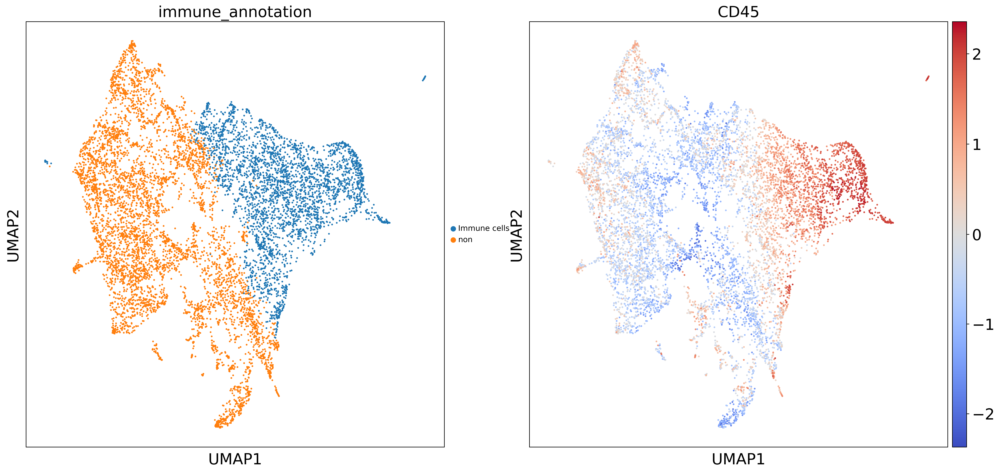

In [8]:
sc.pl.umap(ROI12, color=['immune_annotation', 'CD45'], s=20, use_raw=False,  legend_fontsize=10, color_map='coolwarm', vcenter=0)
#sc.pl.umap(ROI12, color=['annotation'], s=20, use_raw=False, legend_fontsize=7,  title = 'ROI12', legend_loc='on data', save = name + '_logOnData.pdf')

# First annotation of original Leiden

In [9]:
first_annotationPresentation = {
'0' : 'Tumour cells', 
'3' : 'Tumour cells',  
'18' : 'Tumour cells', 
'24' : 'Tumour cells', 
'30' : 'Tumour cells', 

}
ROI12.obs['first_annotationPresentation'] = (ROI12.obs['leiden'].map(first_annotationPresentation).astype('category'))

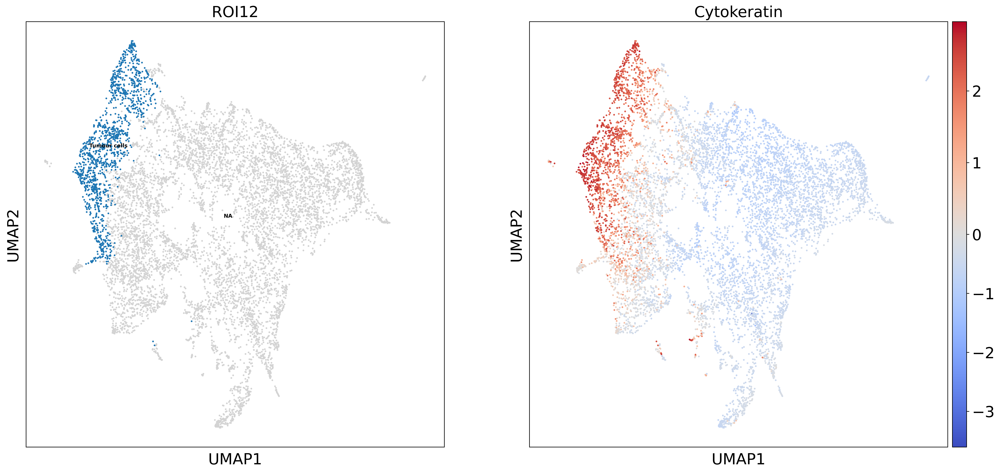

In [10]:
sc.pl.umap(ROI12, color=['first_annotationPresentation', 'Cytokeratin'], s=20, use_raw=False, legend_fontsize=7,  title = 'ROI12', legend_loc='on data', color_map='coolwarm', vcenter=0)

In [11]:
first_annotation = {
'0' : 'Tumour cells', 
'1' : 'Activated B cells', 
'2' : 'CAF', 
'3' : 'Tumour cells', 
'4' : 'Dendritic cells',  
'5' : 'Collagen', 
'6' : 'Regulatory T cells', 
'7' : 'Regulatory T cells', 
'8' : 'CD8+ T cells', 
'9' : 'NK cells/ Granulocyte/ CAF', 
'10' : 'Collagen',  
'11' : 'Fibroblasts',  
'12' : 'Fibroblasts', 
'13' : 'Collagen', 
'14' : 'Collagen', 
'15' : 'CD4+ T cells', 
'16' : 'Collagen', 
'17' : 'CD4+ T cells', 
'18' : 'Tumour cells', 
'19' : 'Lympathic vessles', 
'20' : 'Lympathic vessles', 
'21' : 'Plasma cells', 
'22' : 'Granulocyte', 
'23' : 'Fibroblasts', 
'24' : 'Tumour cells', 
'25' : 'Granulocyte/ CD8+ T cells', 
'26' : 'Fibroblasts', 
'27' : 'Collagen', 
'28' : 'Collagen', 
'29' : 'Collagen', 
'30' : 'Tumour cells', 
'31' : 'Collagen', 
'32' : 'Granulocyte', 
'33' : 'Plasma cells', 
'34' : 'Fibroblasts', 
'35' : 'Collagen', 
'36' : 'NK cells', 
'37' : 'Fibroblasts', 
'38' : 'Fibroblasts', 
'39' : 'Fibroblasts', 
'40' : 'Endothelial ', 
'41' : 'B cells', 
'42' : 'Dendritic cells/ Mast cells', 
'43' : 'Unknown', 
    

 

}
ROI12.obs['first_annotation'] = (ROI12.obs['leiden'].map(first_annotation).astype('category'))

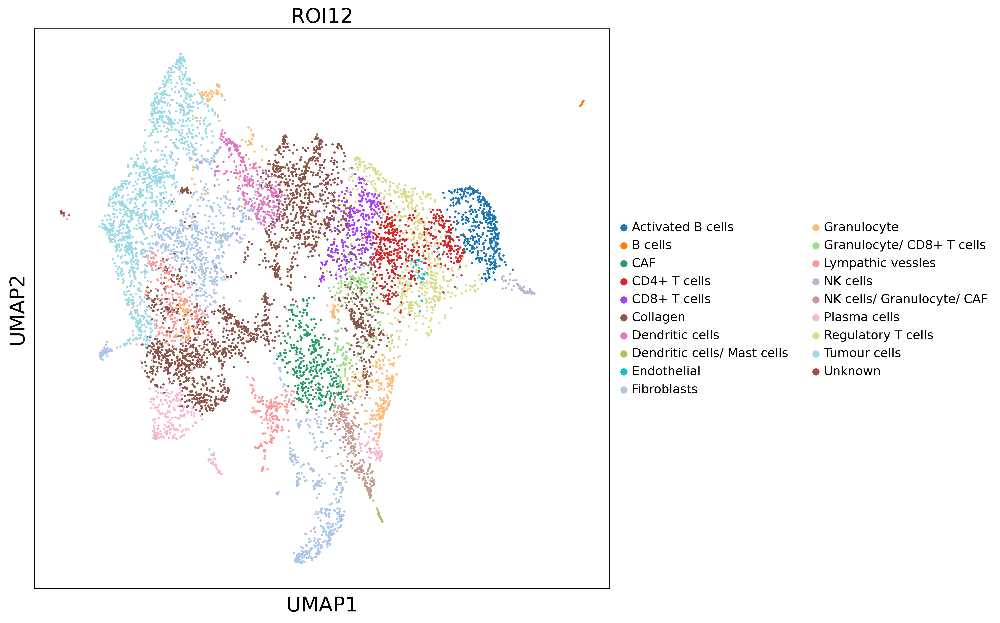

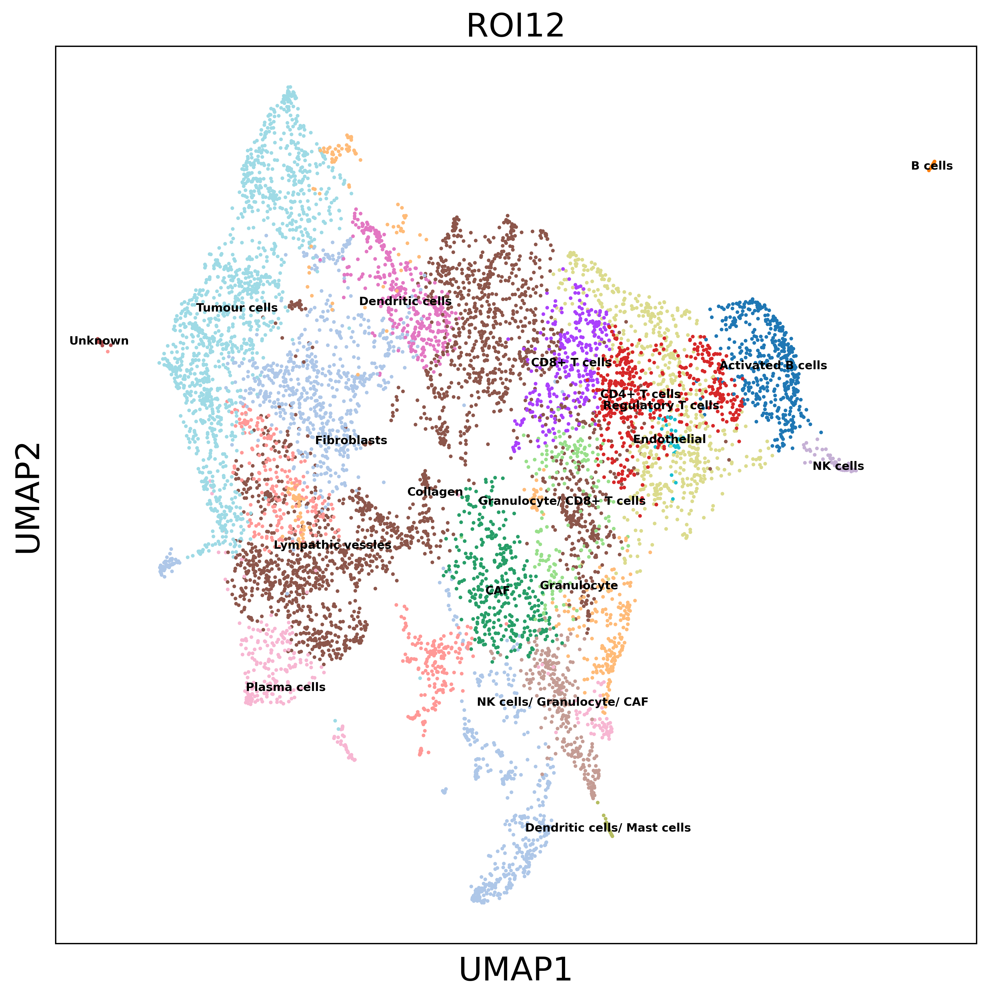

In [12]:
#sc.settings.set_figure_params(dpi=220, fontsize=5, dpi_save=700, figsize=(10,10))
sc.pl.umap(ROI12, color=['first_annotation'], s=20, use_raw=False,  legend_fontsize=12, title = 'ROI12', color_map='coolwarm', vcenter=0)
sc.pl.umap(ROI12, color=['first_annotation'], s=20, use_raw=False, legend_fontsize=7,  title = 'ROI12', legend_loc='on data', color_map='coolwarm', vcenter=0)

# Choose cluster

In [13]:
# get IDs for every Cluster
def getCluster(numCluster):
    id_of_cluster = [key for key, val in  ROI12.obs['leiden'].items() if val == str(numCluster)] # get all IDs of one cluster
    data = ROI12.to_df().loc[id_of_cluster] # generate a dataframe with only the IDs of one cluster 
    return data

In [14]:
cluster0 = getCluster(0)
cluster1 = getCluster(1)
cluster2 = getCluster(2)
cluster3 = getCluster(3)
cluster4 = getCluster(4)
cluster5 = getCluster(5)
cluster6 = getCluster(6)
cluster7 = getCluster(7)
cluster8 = getCluster(8)
cluster9 = getCluster(9)
cluster10 = getCluster(10)
cluster11 = getCluster(11)
cluster12 = getCluster(12)
cluster13 = getCluster(13)
cluster14 = getCluster(14)
cluster15 = getCluster(15)
cluster16 = getCluster(16)
cluster17 = getCluster(17)
cluster18 = getCluster(18)
cluster19 = getCluster(19)
cluster20 = getCluster(20)
cluster21 = getCluster(21)
cluster22 = getCluster(22)
cluster23 = getCluster(23)
cluster24 = getCluster(24)
cluster25 = getCluster(25)
cluster26 = getCluster(26)
cluster27 = getCluster(27)
cluster28 = getCluster(28)
cluster29 = getCluster(29)
cluster30 = getCluster(30)
cluster31 = getCluster(31)
cluster32 = getCluster(32)
cluster33 = getCluster(33)
cluster34 = getCluster(34)
cluster35 = getCluster(35)
cluster36 = getCluster(36)
cluster37 = getCluster(37)
cluster38 = getCluster(38)
cluster39 = getCluster(39)
cluster40 = getCluster(40)
cluster41 = getCluster(41)
cluster42 = getCluster(42)
cluster43 = getCluster(43)

In [15]:
cluster0 = AnnData(cluster0)
cluster1 = AnnData(cluster1)
cluster2 = AnnData(cluster2)
cluster3 = AnnData(cluster3)
cluster4 = AnnData(cluster4)
cluster5 = AnnData(cluster5)
cluster6 = AnnData(cluster6)
cluster7 = AnnData(cluster7)
cluster8 = AnnData(cluster8)
cluster9 = AnnData(cluster9)
cluster10 = AnnData(cluster10)
cluster11 = AnnData(cluster11)
cluster12 = AnnData(cluster12)
cluster13 = AnnData(cluster13)
cluster14 = AnnData(cluster14)
cluster15 = AnnData(cluster15)
cluster16 = AnnData(cluster16)
cluster17 = AnnData(cluster17)
cluster18 = AnnData(cluster18)
cluster19 = AnnData(cluster19)
cluster20 = AnnData(cluster20)
cluster21 = AnnData(cluster21)
cluster22 = AnnData(cluster22)
cluster23 = AnnData(cluster23)
cluster24 = AnnData(cluster24)
cluster25 = AnnData(cluster25)
cluster26 = AnnData(cluster26)
cluster27 = AnnData(cluster27)
cluster28 = AnnData(cluster28)
cluster29 = AnnData(cluster29)
cluster30 = AnnData(cluster30)
cluster31 = AnnData(cluster31)
cluster32 = AnnData(cluster32)
cluster33 = AnnData(cluster33)
cluster34 = AnnData(cluster34)
cluster35 = AnnData(cluster35)
cluster36 = AnnData(cluster36)
cluster37 = AnnData(cluster37)
cluster38 = AnnData(cluster38)
cluster39 = AnnData(cluster39)
cluster40 = AnnData(cluster40)
cluster41 = AnnData(cluster41)
cluster42 = AnnData(cluster42)
cluster43 = AnnData(cluster43)

## PCA

In [16]:
def pc(data1):
    sc.settings.set_figure_params(dpi=50, fontsize=10,figsize=(8,8))
    sc.tl.pca(data1, svd_solver='arpack')
    sc.pl.pca_variance_ratio(data1, log=False, n_pcs=50)

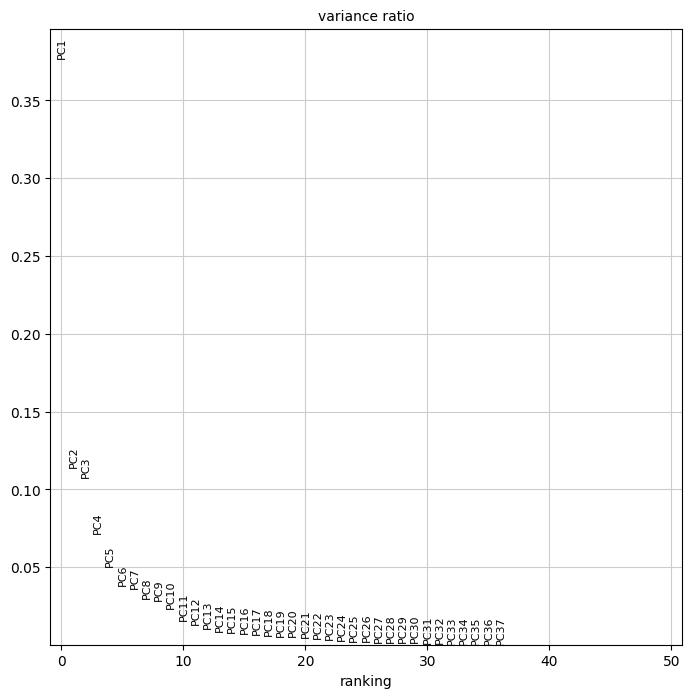

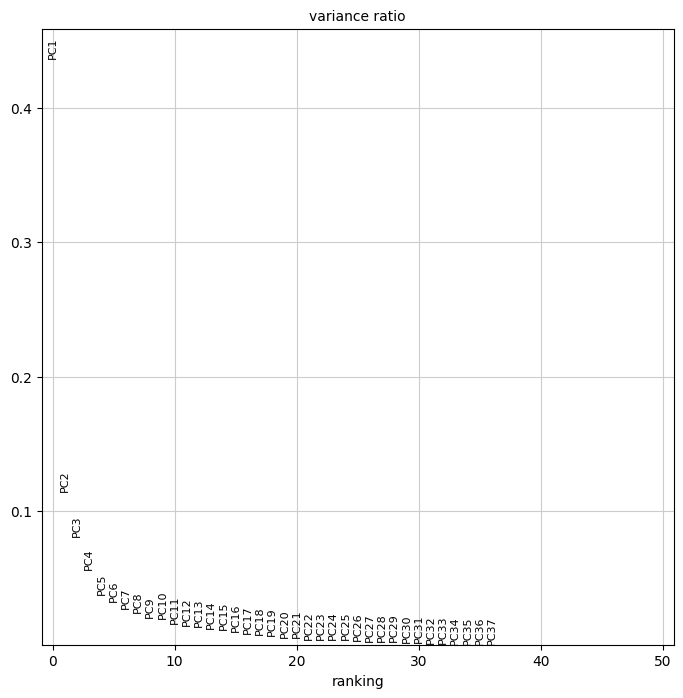

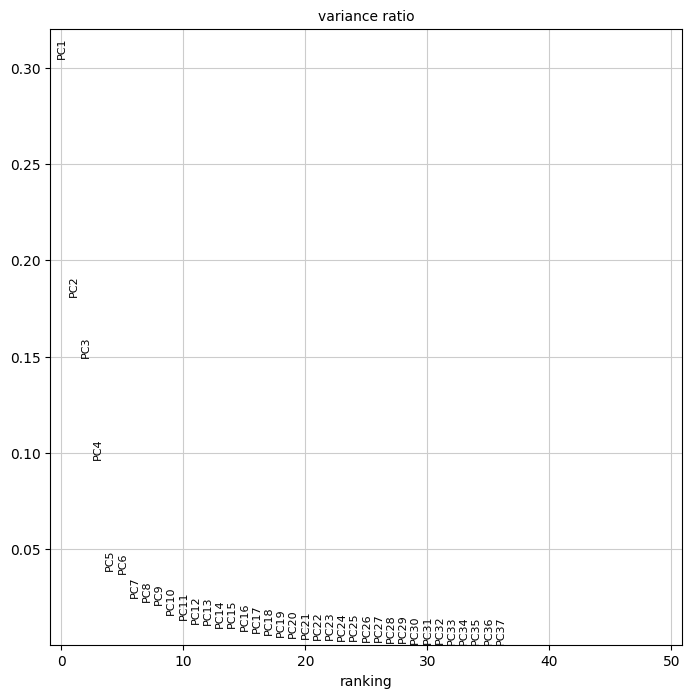

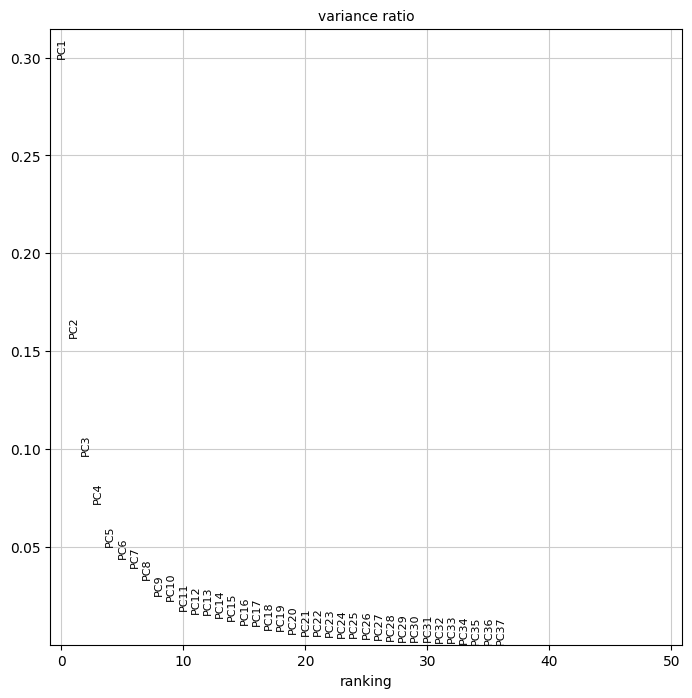

In [17]:
#pc(cluster0) 
pc(cluster1) 
#pc(cluster2) 
#pc(cluster3)
#pc(cluster4)
#pc(cluster5) 
#pc(cluster6)
#pc(cluster7)
#pc(cluster8)
pc(cluster9)
pc(cluster10) 
#pc(cluster11)
#pc(cluster12) 
#pc(cluster13)
#pc(cluster14) 
#pc(cluster15)
#pc(cluster16)
#pc(cluster17)
#pc(cluster18)
#pc(cluster20)
#pc(cluster22) 
pc(cluster25)

In [18]:
pc0 =4
pc1 =4
pc2 =3
pc3 =4
pc4 =5
pc5 =4
pc6 =4
pc7 =5
pc8 =3
pc9= 5
pc10 =5
pc11 =3
pc12 =6
pc13 =6
pc14 =5
pc15 =5
pc16 =4
pc17 =4
pc18 =5
pc19 =6
pc20 =7
pc22 =5
pc25 =5

## Generate UMAPs for Subcluster

In [19]:
def umap(data1, pc1, subcluster, res):
    sc.settings.set_figure_params(dpi=100, fontsize=12,figsize=(10,10))
    # Computing the neighborhood graph
    sc.pp.neighbors(data1, n_neighbors=15, n_pcs=pc1)
    sc.tl.umap(data1, random_state=0, min_dist=0.3, spread=0.4) 
    sc.tl.leiden(data1,resolution=res, key_added = "leiden")
    
    
    #plot results
    sc.pl.umap(data1, color ='leiden', s=60, use_raw=False, title = name + ' Cluster ' + subcluster, save=  name + '_' + subcluster + '.pdf')

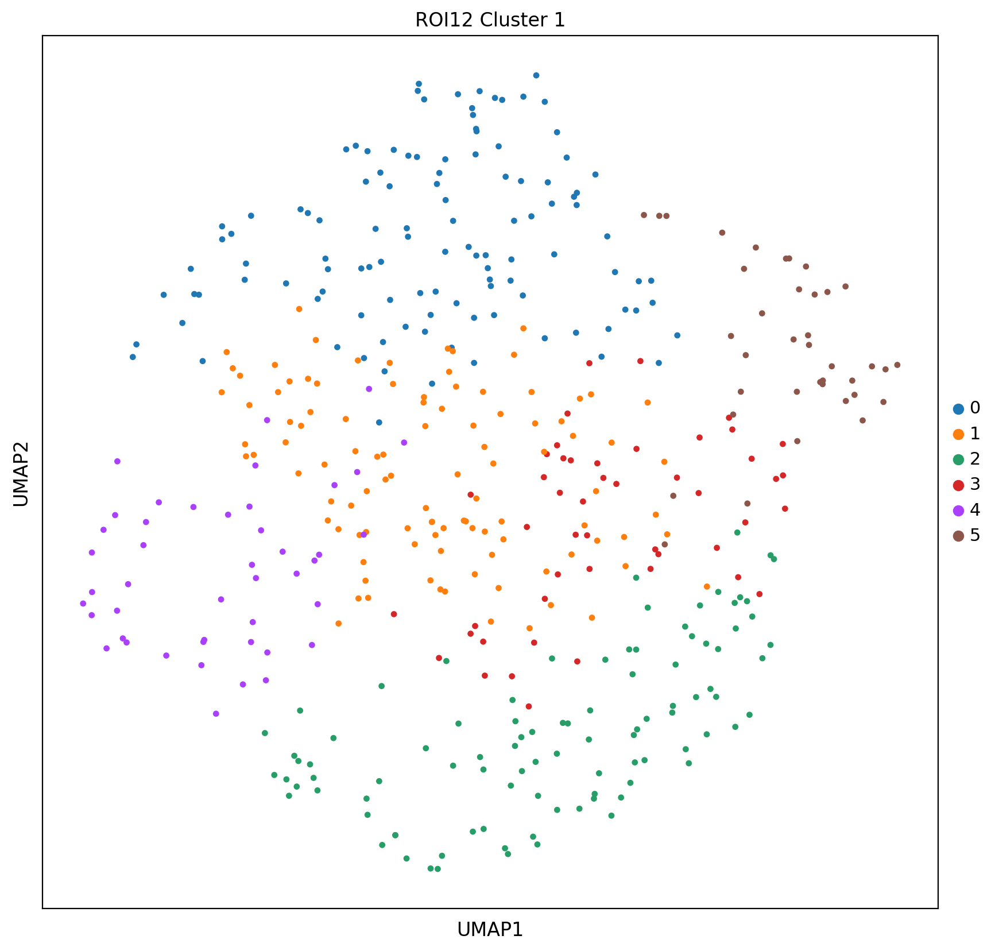

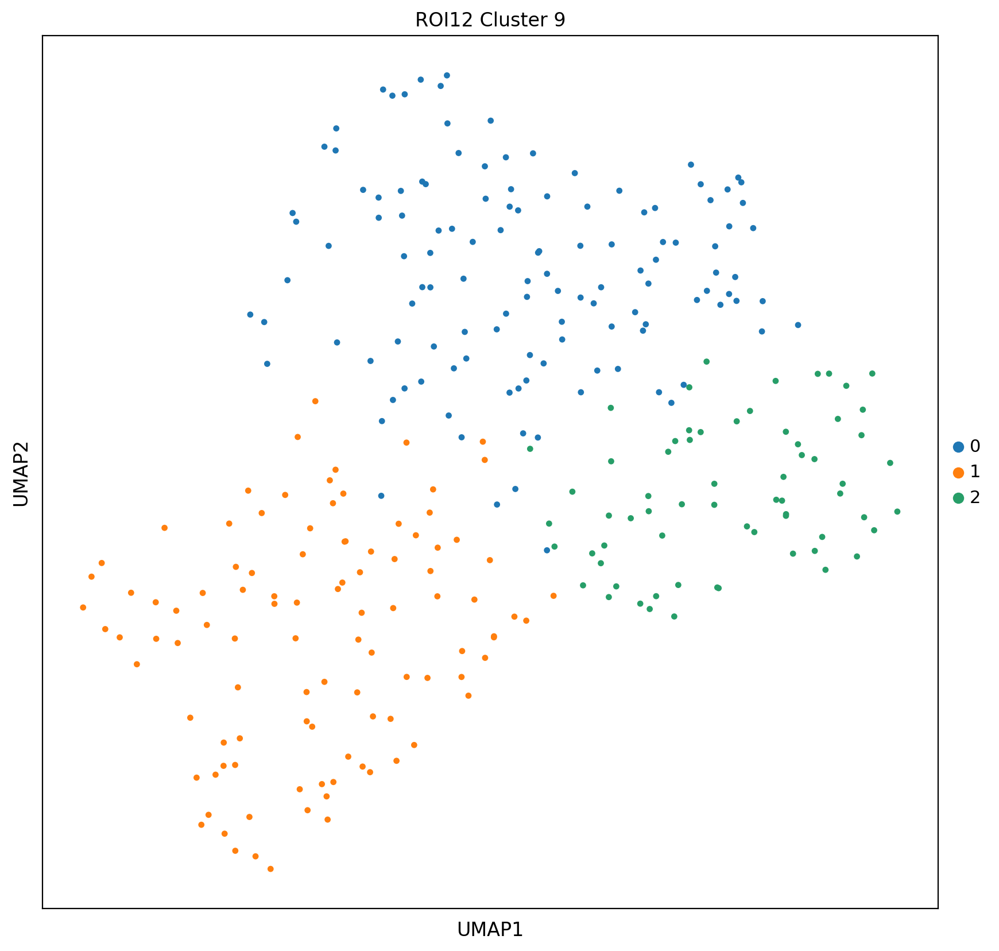

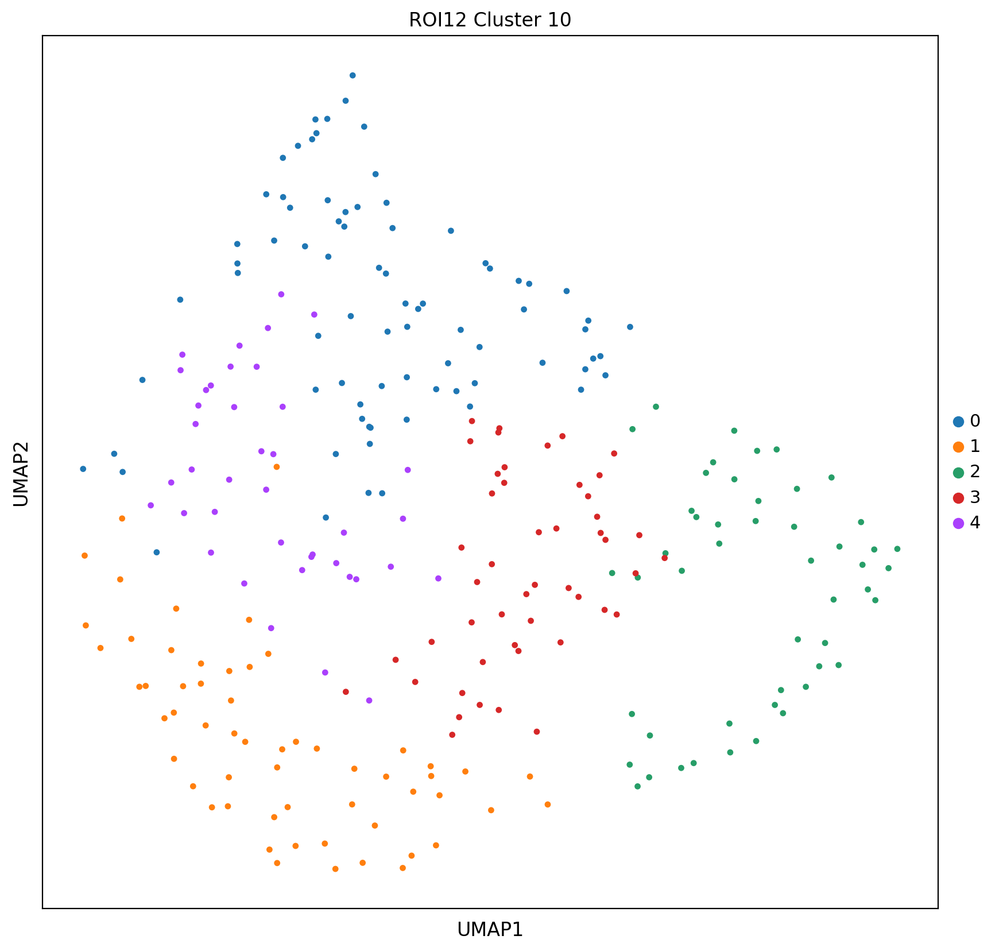

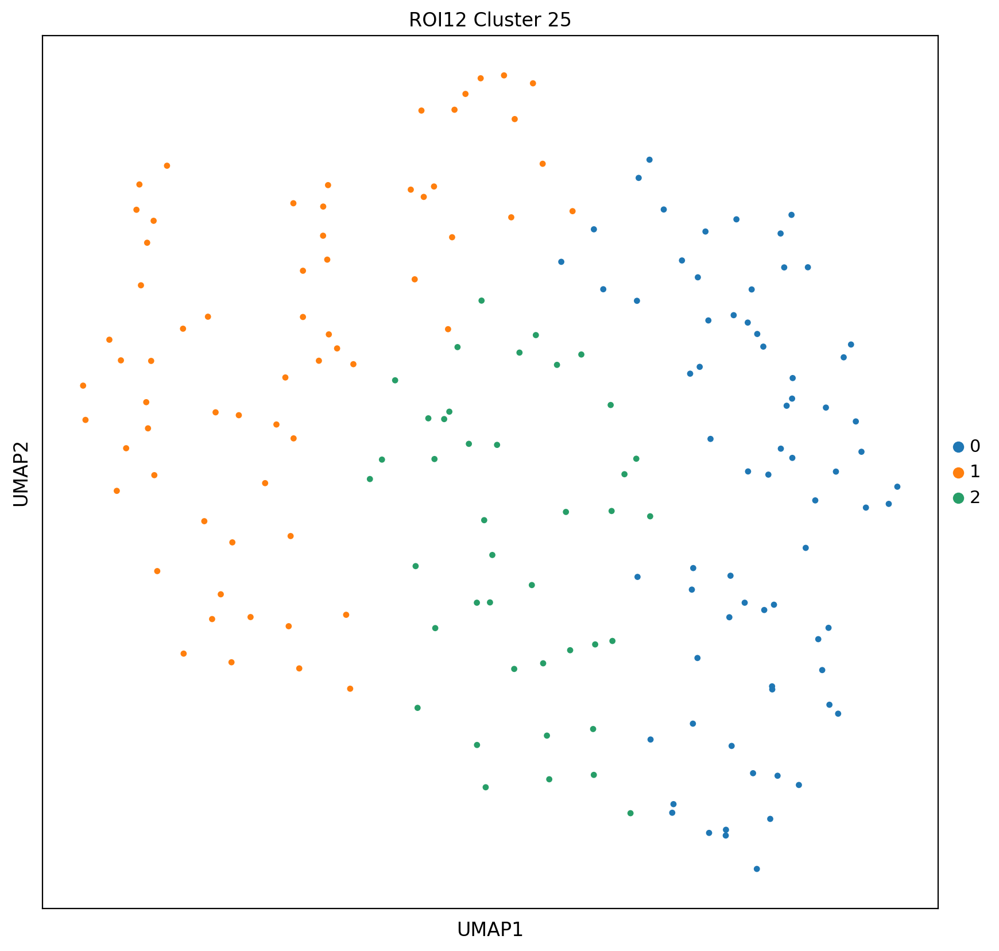

In [20]:
#umap(cluster0, pc0, '0', 0.8)
umap(cluster1, pc1, '1', 0.5)
#umap(cluster2, pc2, '2', 0.7)
#umap(cluster3, pc3, '3', 0.5)
#umap(cluster4, pc4, '4', 1.2)
#umap(cluster5, pc5, '5', 0.5)
#umap(cluster6, pc6, '6', 0.5)
#umap(cluster7, pc7, '7', 1)
#umap(cluster8, pc8, '8', 0.5)
umap(cluster9, pc9, '9', 0.5)
umap(cluster10, pc10, '10', 0.5)
#umap(cluster11, pc11, '11', 0.5)
#umap(cluster12, pc12, '12', 0.6)
#umap(cluster13, pc13, '13', 0.5)
#umap(cluster14, pc14, '14', 0.5)
#umap(cluster15, pc15, '15', 0.7)
#umap(cluster16, pc16, '16', 0.9)
#umap(cluster17, pc17, '17', 0.5)
#umap(cluster18, pc18, '18', 0.5)
#umap(cluster19, pc19, '19', 0.5)
#umap(cluster20, pc20, '20', 0.5)
#umap(cluster22, pc22, '22', 0.9)
umap(cluster25, pc25, '25', 0.5)

## Generate Heatmaps for Subcluster

In [21]:
# median per cluster for heatmap
def median_cluster(data, numOfCluster, cluster):
    cluster_count = 0
    cluster_df = pd.DataFrame(columns=data.columns.to_list())

    while cluster_count < numOfCluster:
        id_of_cluster = [key for key, val in cluster.items() if val == str(cluster_count)] # get all IDs of one cluster
        df_of_cluster = data.loc[id_of_cluster] # generate a dataframe with only the IDs of one cluster 
        median_of_cluster = df_of_cluster.median().to_frame().T # compute the median per marker (column)
        cluster_df = pd.concat([cluster_df, median_of_cluster]) # merge the median results in a dataframe
        cluster_count += 1
    
    cluster_df = cluster_df.reset_index()
    cluster_df = cluster_df.drop('index', axis=1)

    return cluster_df

In [22]:
#cluster0_data = median_cluster(cluster0.to_df(), 9, cluster0.obs['leiden'])
cluster1_data  = median_cluster(cluster1.to_df(), 6, cluster1.obs['leiden'])
#cluster2_data  = median_cluster(cluster2.to_df(), 6, cluster2.obs['leiden'])
#cluster3_data  = median_cluster(cluster3.to_df(), 6, cluster3.obs['leiden'])
#cluster4_data  = median_cluster(cluster4.to_df(), 13, cluster4.obs['leiden'])
#cluster5_data  = median_cluster(cluster5.to_df(), 5, cluster5.obs['leiden'])
#cluster6_data  = median_cluster(cluster6.to_df(), 6, cluster6.obs['leiden'])
#cluster7_data  = median_cluster(cluster7.to_df(), 11, cluster7.obs['leiden'])
#cluster8_data  = median_cluster(cluster8.to_df(), 7, cluster8.obs['leiden'])
cluster9_data  = median_cluster(cluster9.to_df(), 3, cluster9.obs['leiden'])
cluster10_data  = median_cluster(cluster10.to_df(), 5, cluster10.obs['leiden'])
#cluster11_data  = median_cluster(cluster11.to_df(), 4, cluster11.obs['leiden'])
#cluster12_data  = median_cluster(cluster12.to_df(), 7, cluster12.obs['leiden'])
#cluster13_data  = median_cluster(cluster13.to_df(), 5, cluster13.obs['leiden'])
#cluster14_data  = median_cluster(cluster14.to_df(), 7, cluster14.obs['leiden'])
#cluster15_data  = median_cluster(cluster15.to_df(), 6, cluster15.obs['leiden'])
#cluster16_data  = median_cluster(cluster16.to_df(), 6, cluster16.obs['leiden'])
#cluster17_data  = median_cluster(cluster17.to_df(), 6, cluster17.obs['leiden'])
#cluster18_data  = median_cluster(cluster18.to_df(), 4, cluster18.obs['leiden'])
#cluster19_data  = median_cluster(cluster19.to_df(), 3, cluster19.obs['leiden'])
#cluster20_data  = median_cluster(cluster20.to_df(), 3, cluster20.obs['leiden'])
#cluster22_data  = median_cluster(cluster22.to_df(), 3, cluster22.obs['leiden'])
cluster25_data  = median_cluster(cluster25.to_df(), 3, cluster25.obs['leiden'])

In [23]:
sns.set(font_scale=0.8)
def plotHeatmap(data, name, subcluster):
    plot= sns.clustermap(data.T,
                         standard_scale=1,  # Either 0 (rows) or 1 (columns).
                         cmap='Reds', 
                         yticklabels=True, xticklabels=True,
                         figsize=(10, 10),
                         row_cluster=False,
                         col_cluster=True)
    plot.fig.suptitle(name + ' Cluster ' + str(subcluster))
    plot = plt.savefig('results_subcluster_ROI12/matrixplot' + name + '_' + str(subcluster) + '.pdf', dpi=150);

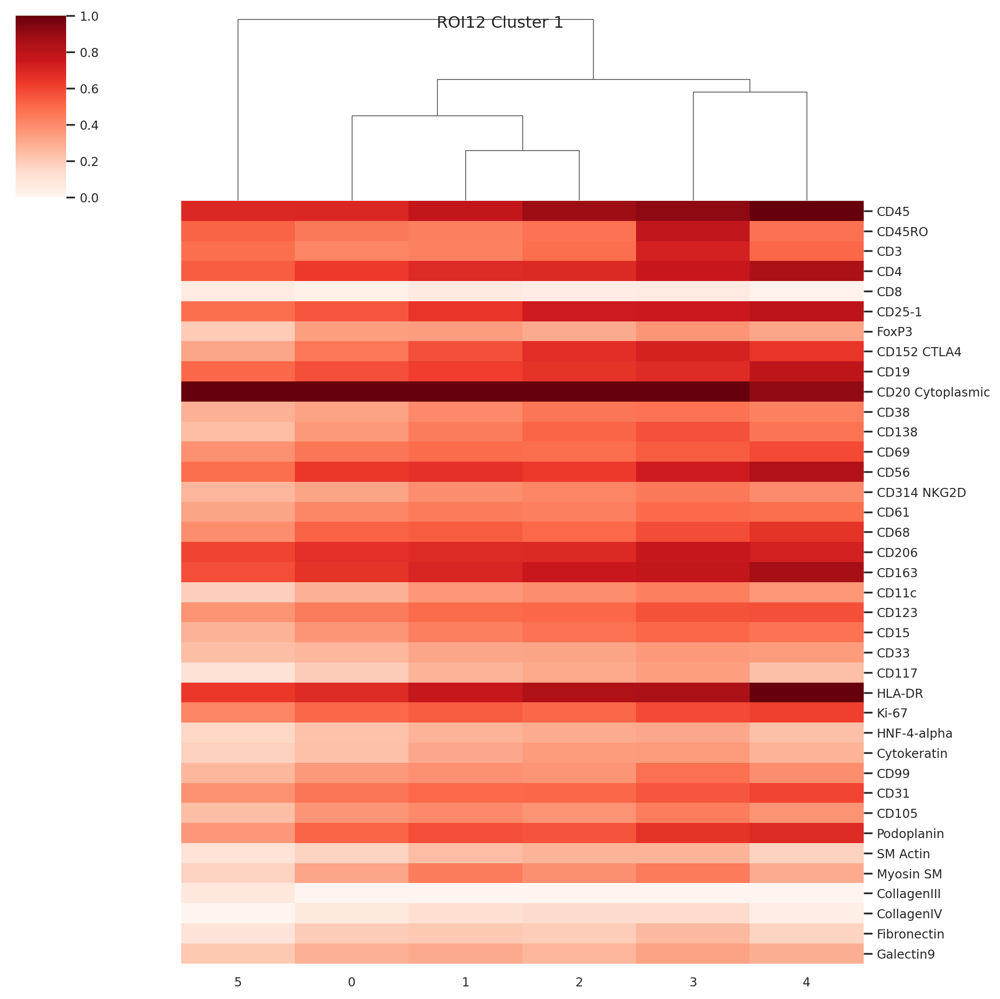

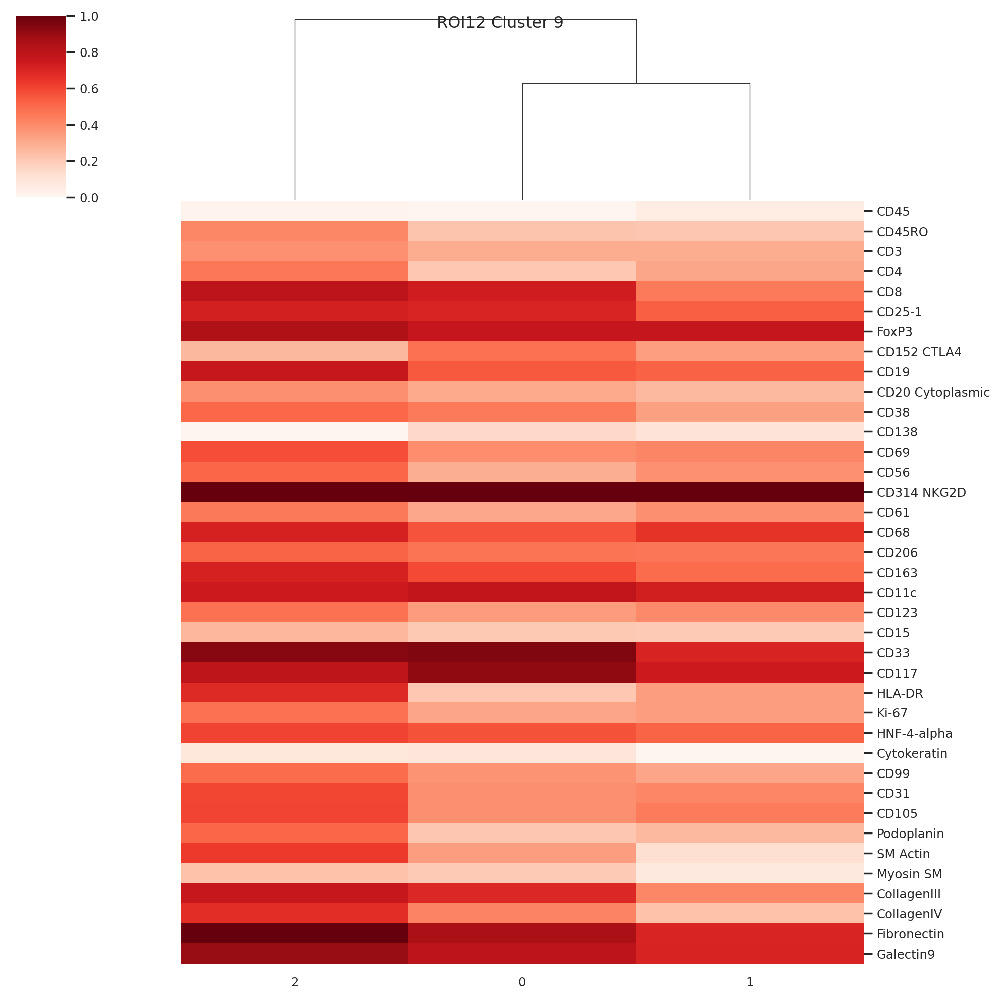

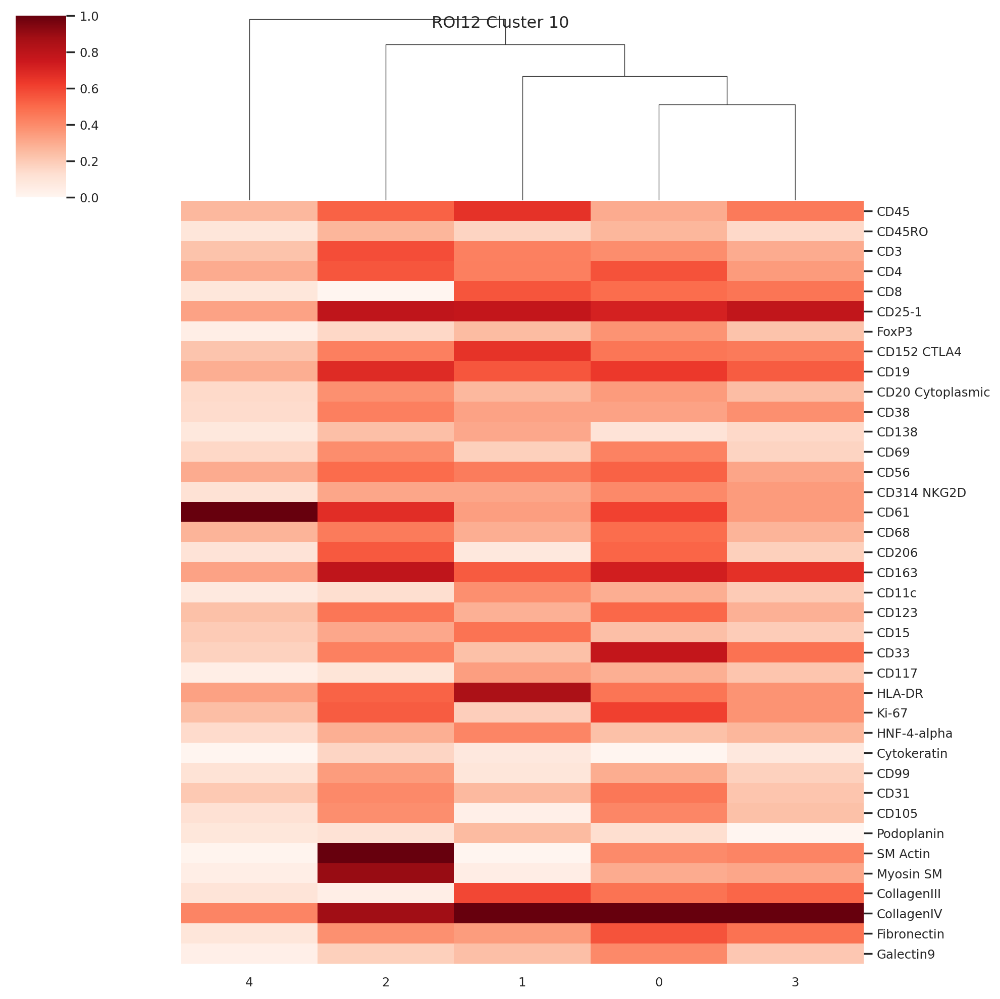

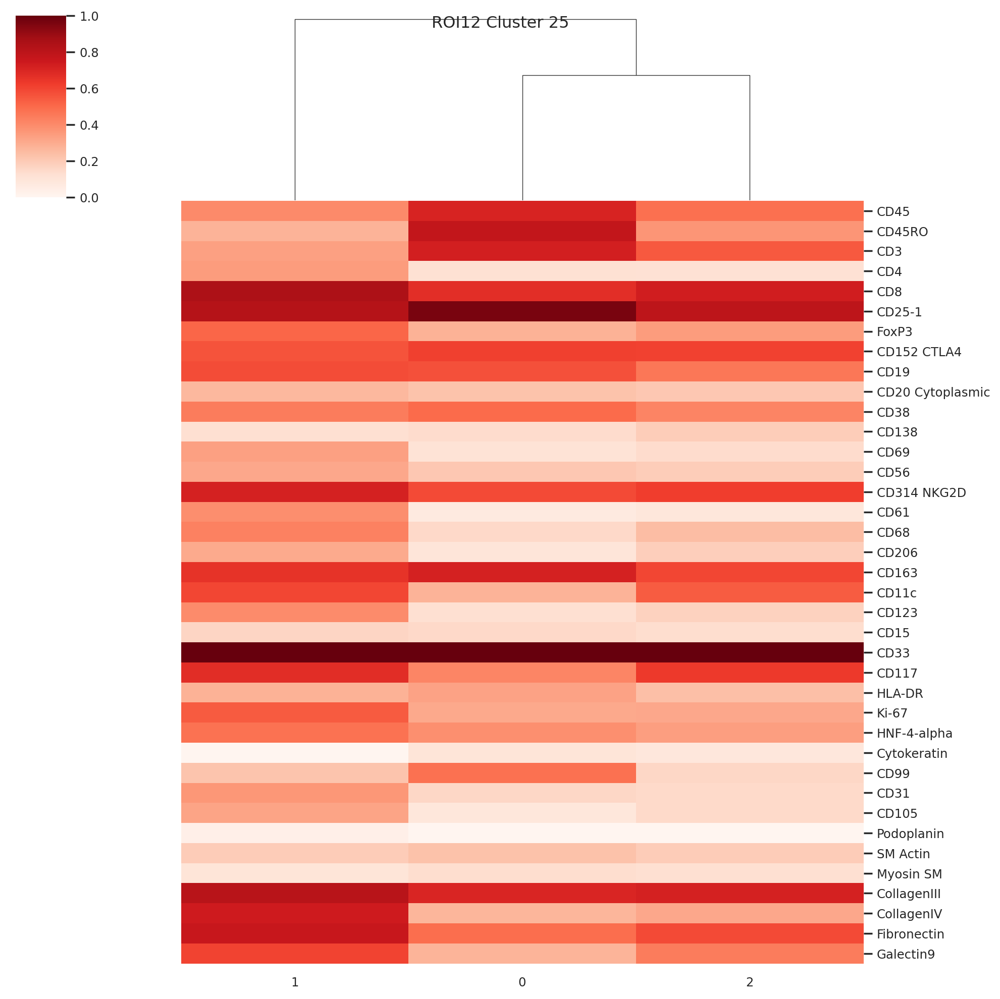

In [24]:
#plotHeatmap(cluster0_data, name, 0 )
plotHeatmap(cluster1_data, name, 1)
#plotHeatmap(cluster2_data, name, 2)
#plotHeatmap(cluster3_data, name, 3)
#plotHeatmap(cluster4_data, name, 4)
#plotHeatmap(cluster5_data, name, 5)
#plotHeatmap(cluster6_data, name, 6)
#plotHeatmap(cluster7_data, name, 7)
#plotHeatmap(cluster8_data, name, 8)
plotHeatmap(cluster9_data, name, 9)
plotHeatmap(cluster10_data, name, 10)
#plotHeatmap(cluster11_data, name, 11)
#plotHeatmap(cluster12_data, name, 12)
#plotHeatmap(cluster13_data, name, 13)
#plotHeatmap(cluster14_data, name, 14)
#plotHeatmap(cluster15_data, name, 15)
#plotHeatmap(cluster16_data, name, 16)
#plotHeatmap(cluster17_data, name, 17)
#plotHeatmap(cluster19_data, name, 19)
#plotHeatmap(cluster18_data, name, 18)
#plotHeatmap(cluster20_data, name, 20)
#plotHeatmap(cluster22_data, name, 22)
plotHeatmap(cluster25_data, name, 25)

In [25]:
def countsPerCluster(data):
    ser_counts = data.obs['leiden'].value_counts()
    ser_counts.name = 'cell counts'
    meta_leiden = pd.DataFrame(ser_counts)
    return meta_leiden

In [26]:
cellCounts = countsPerCluster(cluster10)

In [27]:
cellCounts['cell counts'].to_list()

[78, 57, 49, 48, 40]

# Assigne new Subcluster to ROI

In [28]:
def listOfSubcluster(current_subcluster, clusterNum, index):
    newList = []
    for idx in range(len(current_subcluster)):
        newEntry = clusterNum + '.' + current_subcluster[idx]
        newList.append(newEntry)
    newdf = pd.DataFrame(data = newList, index = index)
    return newdf

In [29]:
# new Subcluster Lists
#df0 = listOfSubcluster(cluster0.obs['leiden'].to_list(), '0', cluster0.obs['leiden'].index)
df1 = listOfSubcluster(cluster1.obs['leiden'].to_list(), '1', cluster1.obs['leiden'].index)
#df2 = listOfSubcluster(cluster2.obs['leiden'].to_list(), '2', cluster2.obs['leiden'].index)
#df3 = listOfSubcluster(cluster3.obs['leiden'].to_list(), '3', cluster3.obs['leiden'].index)
#df4 = listOfSubcluster(cluster4.obs['leiden'].to_list(), '4', cluster4.obs['leiden'].index)
#df5 = listOfSubcluster(cluster5.obs['leiden'].to_list(), '5', cluster5.obs['leiden'].index)
df9 = listOfSubcluster(cluster9.obs['leiden'].to_list(), '9', cluster9.obs['leiden'].index)
df10 = listOfSubcluster(cluster10.obs['leiden'].to_list(), '10', cluster10.obs['leiden'].index)
#df11 = listOfSubcluster(cluster11.obs['leiden'].to_list(), '11', cluster11.obs['leiden'].index)
#df12 = listOfSubcluster(cluster12.obs['leiden'].to_list(), '12', cluster12.obs['leiden'].index)
#df14 = listOfSubcluster(cluster14.obs['leiden'].to_list(), '14', cluster14.obs['leiden'].index)
#df18 = listOfSubcluster(cluster18.obs['leiden'].to_list(), '18', cluster18.obs['leiden'].index)
df25 = listOfSubcluster(cluster25.obs['leiden'].to_list(), '25', cluster25.obs['leiden'].index)

In [30]:
def oldCluster(clusterNum):
    id_of_cluster = [key for key, val in ROI12.obs['leiden'].items() if val == str(clusterNum)]
    df = pd.DataFrame(data = ([str(clusterNum)] * len(id_of_cluster)), index = id_of_cluster)
    return df

In [31]:
df0 = oldCluster(0)
#df1 = oldCluster(1)
df2 = oldCluster(2)
df3 = oldCluster(3)
df4 = oldCluster(4)
df5 = oldCluster(5)
df6 = oldCluster(6)
df7 = oldCluster(7)
df8 = oldCluster(8)
#df9 = oldCluster(9)
#df10 = oldCluster(10)
df11 = oldCluster(11)
df12 = oldCluster(12)
df13 = oldCluster(13)
df14 = oldCluster(14)
df15 = oldCluster(15)
df16 = oldCluster(16)
df17 = oldCluster(17)
df18 = oldCluster(18)
df19 = oldCluster(19)
df20 = oldCluster(20)
df21 = oldCluster(21)
df22 = oldCluster(22)
df23 = oldCluster(23)
df24 = oldCluster(24)
#df25 = oldCluster(25)
df26 = oldCluster(26)
df27 = oldCluster(27)
df28 = oldCluster(28)
df29 = oldCluster(29)
df30 = oldCluster(30)
df31 = oldCluster(31)
df32 = oldCluster(32)
df33 = oldCluster(33)
df34 = oldCluster(34)
df35 = oldCluster(35)
df36 = oldCluster(36)
df37 = oldCluster(37)
df38 = oldCluster(38)
df39 = oldCluster(39)
df40 = oldCluster(40)
df41 = oldCluster(41)
df42 = oldCluster(42)
df43 = oldCluster(43)

In [32]:
newCLuster = pd.concat([df0, df1, df2, df3, df4, df5, df6, df7, df8, df9, df10, df11, df12, df13, df14, df15, df16, df17, df18, df19, df20, df21, df22,
                       df23, df24, df25, df26, df27, df28, df29, df30, df31, df32, df33, df34, df35, df36, df37, df38, df39, df40, df41, df42, df43])

In [33]:
ROI12.obs['subLeiden'] = newCLuster

# Heatmap with new subcluster

In [34]:
# median per cluster for heatmap
def median_clusterAll(data, numOfCluster, cluster):
    cluster_count = 0
    cluster_df = pd.DataFrame(columns=data.columns.to_list())

    while cluster_count < numOfCluster:
        id_of_cluster = [key for key, val in cluster.items() if val == str(cluster_count)] # get all IDs of one cluster
        df_of_cluster = data.loc[id_of_cluster] # generate a dataframe with only the IDs of one cluster 
        median_of_cluster = df_of_cluster.median().to_frame().T # compute the median per marker (column)
        cluster_df = pd.concat([cluster_df, median_of_cluster]) # merge the median results in a dataframe
        cluster_count += 1
    
    cluster_df = cluster_df.reset_index()
    cluster_df = cluster_df.drop('index', axis=1)

    return cluster_df

In [35]:
data = median_clusterAll(ROI12.to_df(), 44, ROI12.obs['subLeiden'])
data= data.drop([1, 9, 10, 25], axis=0)

In [36]:
idx0 = np.unique(df0[0].to_list())

In [37]:
def newIdx(df, data):
    idx0 = np.unique(df[0].to_list())
    data['idx'] = idx0
    data = data.set_index('idx')
    return data

In [38]:
df1 = newIdx(df1, cluster1_data)
df9 = newIdx(df9, cluster9_data)
df10 = newIdx(df10, cluster10_data)
df25 = newIdx(df25, cluster25_data)

In [39]:
dataAll = data.append([df1, df9, df10, df25])

In [40]:
sns.set(font_scale=1)
def plotHeatmapAll(data, name):
    plot= sns.clustermap(data.T,
                         standard_scale=1,  # Either 0 (rows) or 1 (columns).
                         cmap='Reds', 
                         yticklabels=True, xticklabels=True,
                         figsize=(19, 20),
                         row_cluster=True,
                         col_cluster=True,
                         dendrogram_ratio=0.1)

    plt.setp(plot.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
    plt.setp(plot.ax_heatmap.xaxis.get_majorticklabels(), rotation=35, ha='right', rotation_mode='anchor')
    plt.subplots_adjust(top=0.98) # space between title and plot
    plot.fig.suptitle('Cell Type Annotation ' + name,  y=1, fontsize=30) 
    plot.fig.subplots_adjust(right=0.7)
    plot.ax_cbar.set_position((0.89, .28, .015, .4))
    plot = plt.savefig('results_subcluster_' + name + '/Newmatrixplot' + name + '.png', dpi=150, bbox_inches='tight');

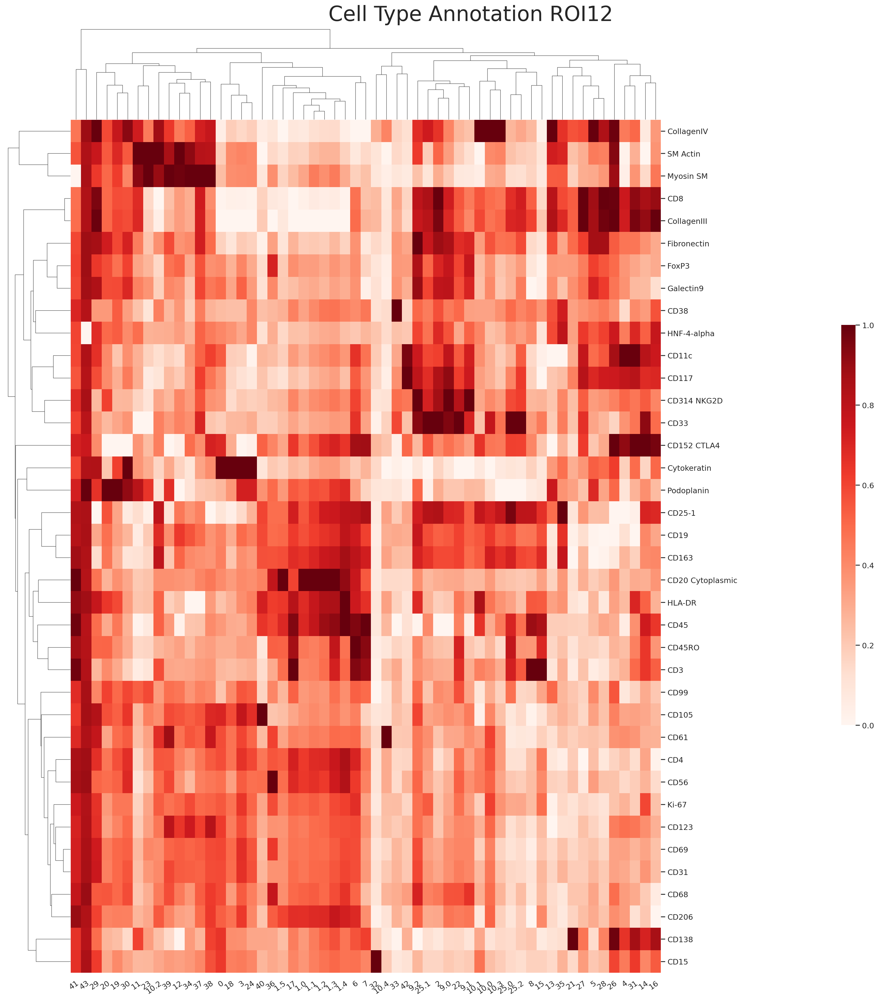

In [41]:
#sc.settings.set_figure_params(dpi=220, fontsize=5, dpi_save=700, figsize=(15,15))
plotHeatmapAll(dataAll, name)

# Annotate

In [42]:
cellTypes=[
'Tumour cells', 
#'Activated B cells', #1
'CAF', 
'Tumour cells', 
'Collagen',  
'Collagen', 
'Regulatory T cells', 
'Regulatory T cells', 
'CD8+ T cells', 
# 'NK cells/ Granulocyte/ CAF',  #9
#'Collagen',  
'Fibroblasts',  
'Fibroblasts', 
'Collagen', 
'Collagen', 
'CD4+ T cells', 
'Collagen', 
'CD4+ T cells', 
'Tumour cells',
'Lymphatic Vessels ', 
'Lymphatic Vessels ', 
'Collagen', 
'Granulocyte', 
'Fibroblasts', 
'Tumour cells',
#'Granulocyte/ CD8+ T cells', 
'Fibroblasts', 
'Collagen', 
'Collagen', 
'Collagen', 
'Tumour cells',
'Collagen', 
'Granulocyte', 
'Plasma cells', 
'Fibroblasts', 
'Collagen', 
'NK cells', 
'Fibroblasts', 
'Fibroblasts', 
'Fibroblasts', 
'Regulatory T cells', 
'B cells', 
'Unknown', 
'Unknown',
    
# 1
'B cells',
'Activated B cells',
'Activated B cells',
'B cells',
'CD4+ T cells',
'B cells',
    
# 9
'CAF', 
'NK cells',
'CAF', 

# 10
'Collagen',
'Collagen',
'Fibroblasts',
'Collagen',
'Megakaryocyte ',
    
# 25
'CD8+ T cells',
'Granulocyte',
'Granulocyte',
]

In [43]:
dataAll.index = cellTypes

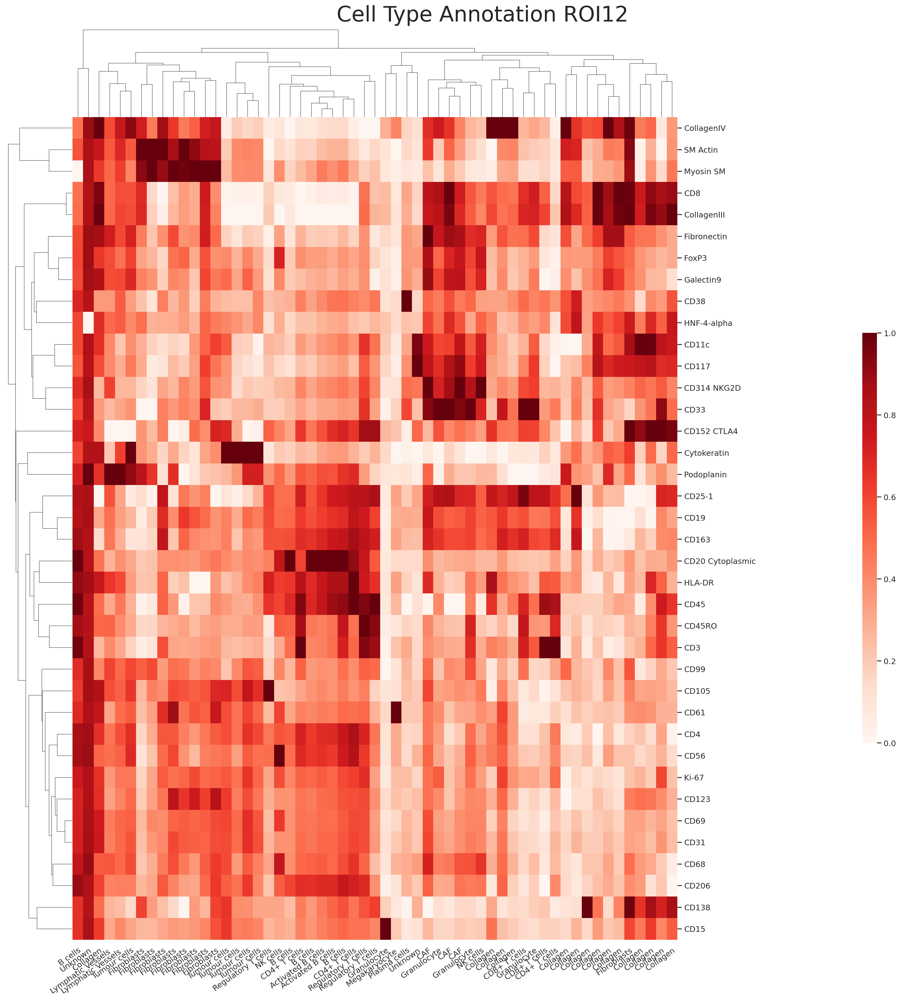

In [44]:
plotHeatmapAll(dataAll, name)

# Merge

In [45]:
annotated_merged_data = dataAll.groupby(level=0).mean()

In [46]:
sc.settings.set_figure_params(dpi=220, fontsize=30, dpi_save=100)
plotHeatmapAll(annotated_merged_data, name)

# Annotated UMAP

In [47]:
old_to_new = {
'0' : 'Tumour cells', 
#'1' : 'Activated B cells', 
'2' : 'CAF', 
'3' : 'Tumour cells', 
'4' : 'Collagen',  
'5' : 'Collagen', 
'6' : 'Regulatory T cells', 
'7' : 'Regulatory T cells', 
'8' : 'CD8+ T cells', 
#'9' : 'NK cells/ Granulocyte/ CAF', 
'10' : 'Regulatory T cells',  
'11' : 'Fibroblasts',  
'12' : 'Fibroblasts', 
'13' : 'Collagen', 
'14' : 'Collagen', 
'15' : 'CD4+ T cells', 
'16' : 'Collagen', 
'17' : 'CD4+ T cells', 
'18' : 'Tumour cells', 
'19' : 'Lympathic vessles', 
'20' : 'Lympathic vessles', 
'21' : 'Collagen', 
'22' : 'Granulocyte', 
'23' : 'Fibroblasts', 
'24' : 'Tumour cells', 
#'25' : 'Granulocyte/ CD8+ T cells', 
'26' : 'Fibroblasts', 
'27' : 'Collagen', 
'28' : 'Collagen', 
'29' : 'Collagen', 
'30' : 'Tumour cells', 
'31' : 'Collagen', 
'32' : 'Granulocyte', 
'33' : 'Plasma cells', 
'34' : 'Fibroblasts', 
'35' : 'Collagen', 
'36' : 'NK cells', 
'37' : 'Fibroblasts', 
'38' : 'Fibroblasts', 
'39' : 'Fibroblasts', 
'40' : 'Regulatory T cells', 
'41' : 'B cells', 
'42' : 'Unknown', 
'43' : 'Unknown', 
    
'1.0' : 'B cells',
'1.1' : 'Activated B cells',
'1.2' : 'Activated B cells',
'1.3' : 'B cells',
'1.4' : 'CD4+ T cells',
'1.5' : 'B cells',
    
'9.0' : 'CAF',
'9.1' : 'NK cells',
'9.2' : 'CAF',
    
'10.0' : 'Collagen',
'10.1' : 'Collagen',
'10.2' : 'Fibroblasts',
'10.3' : 'Collagen',
'10.4' : 'Megakaryocyte ',

'25.0' : 'CD8+ T cells',
'25.1' : 'Granulocyte',
'25.2' : 'Granulocyte',
}
ROI12.obs['annotation'] = (ROI12.obs['subLeiden'].map(old_to_new).astype('category'))

Consider running `set_figure_params(dpi_save=...)`, which will adjust `matplotlib.rcParams['savefig.dpi']`


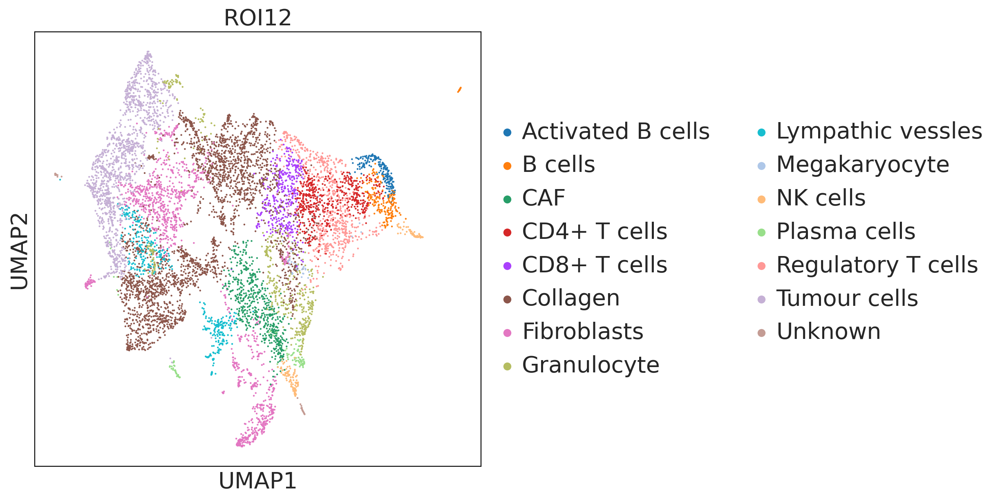

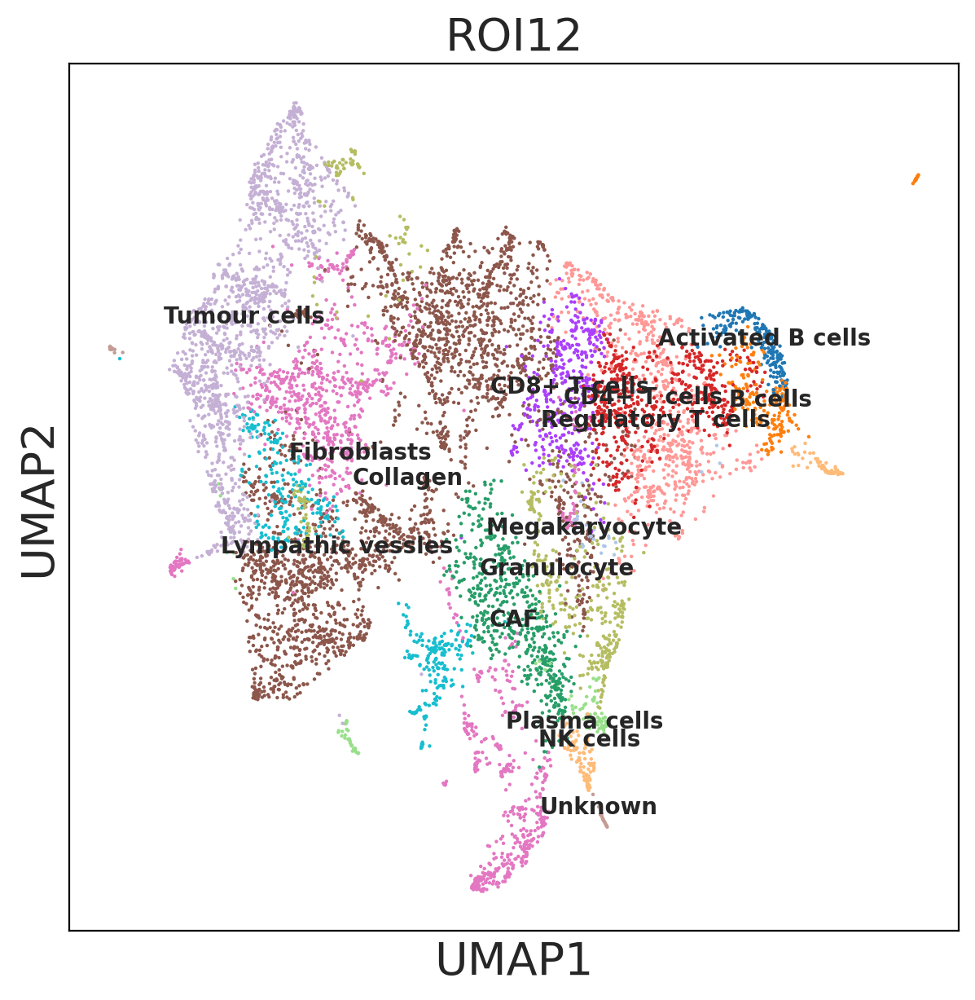

In [48]:
sc.settings.set_figure_params(dpi=100, fontsize=20, dpi_save=100, figsize=(7,7))
sc.pl.umap(ROI12, color=['annotation'], s=10, use_raw=False,  legend_fontsize=20, title = name, save = name + '.png', color_map='coolwarm', vcenter=0)
sc.pl.umap(ROI12, color=['annotation'], s=10, use_raw=False, legend_fontsize=10,  title = name, legend_loc='on data', save = name + '_logOnData.pdf', color_map='coolwarm', vcenter=0)

In [49]:
selced_marker = [
'CD45',  
'CD45RO',   
'CD3',
# CD2,
'CD4',
'CD8',    
'CD25-1',     
'FoxP3',
'CD152 CTLA4',   
#PD-L1
'CD19',     
'CD20 Cytoplasmic',
'CD38',     
'CD138', 
'CD69',    
'CD56',    
'CD314 NKG2D',     
'CD61',
'CD68', 
'CD206',     
'CD163',# IN ROI19 on Tumour cells       
'CD11c', 
'CD123',
'CD15',    
'CD33',  
'CD117',   
'HLA-DR',
'Ki-67',     
'HNF-4-alpha',  
'Cytokeratin',    
'CD99',
'CD31',    
'CD105',    
'Podoplanin',
'SM Actin',
'Myosin SM',
'CollagenIII',
'CollagenIV',
'Fibronectin',
'Galectin9',    
]

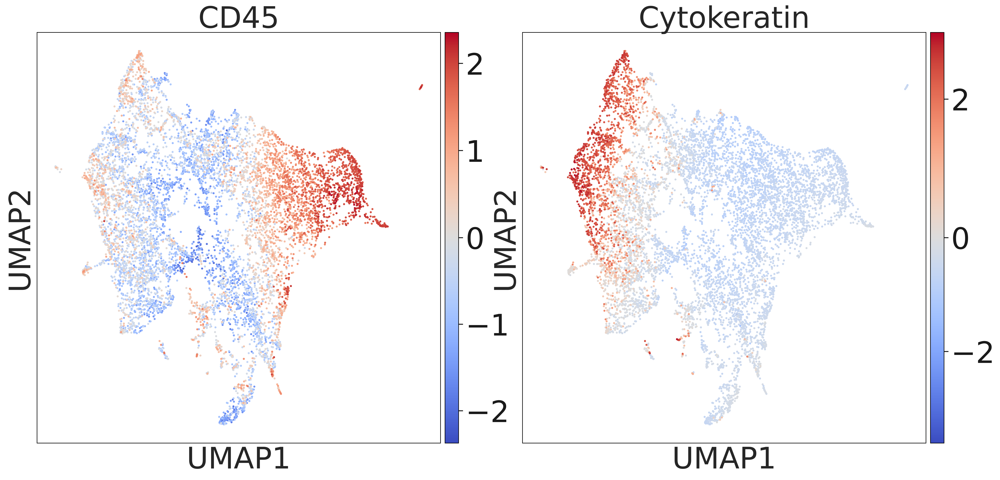

In [50]:
sc.settings.set_figure_params(dpi=220, fontsize=40, dpi_save=700, figsize=(10,10))
sc.pl.umap(ROI12, color=['CD45', 'Cytokeratin'], s=30, use_raw=False,  legend_fontsize=12, color_map='coolwarm', vcenter=0, save = name + '_Expression.pdf',)

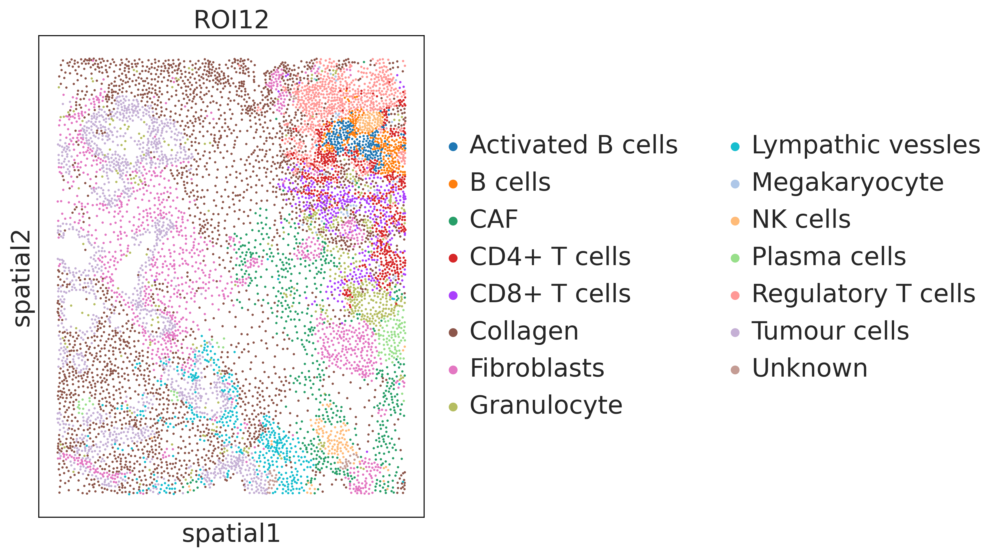

In [51]:
sc.settings.set_figure_params(dpi=160, fontsize=20, dpi_save=150, figsize=(7,7))
sc.pl.spatial(ROI12, color="annotation", spot_size=40, scale_factor=1, legend_fontsize=20, save = '_Spatial' + name + '.png', title = name)

In [52]:
dict_types = types.to_dict()

NameError: name 'types' is not defined